# AVAlanche of Music: Explainer Notebook for Network Build
Website : https://sites.google.com/view/avalanche-of-music/

Lyric analysis is in the LyricAnalysis file

---

In [1]:
# imports
import os
import re
import json
import scipy
import numpy as np
import pandas as pd
from tabulate import tabulate

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("whitegrid")

import networkx as nx
import urllib.request
from tqdm.auto import tqdm

# 1. Motivation
### What is your dataset?
#### A. Network. 
- Our dataset is all about music artists and to start creating our network, we needed a list of artist's names. Rather than scrapping Wikipedia's long and convoluted categories and lists of musicians, we decided on using Genius database of artists. We took all 18770 names listed on [All Artists on Genius](https://genius.com/artists). 

- However, as explained in more details in Section 2, this list required to be preprocessed, enriched and cleaned. All in all, we ended up with 10191 Wikipedia page names from which we created the complete network.

- From this list, we queried each Wikipedia page to retreive its content, using Wikipedia API as done in Week 1 and 4. As node attributes, we decided to extract from each page the artist's birth year and genres (if specified, otherwise 'Unknown') from the Infobox, as well as the length of the page (number of characters). We also extracted all the links to other wikipedia pages and keep them as edges if they link to another artist in the dataset.

#### B. Lyrics
- We identified all nodes from the GCC that have a degree of >= 90 (aka the total amount of in and out links from their wiki page) and added them to our initial list. We further reviewed the list and determined if the artists have actual lyrics attached to them in Genius. We did this by attempting to download songs from all of the artists using the Genius Lyrics API. During this process we realised some did not have actual lyrics attached to them (such as if they are a DJ, or a singer attached to a band that has lyrics) - so we removed them. We also encountered various name differences between the node names and the artist name that Genius expected, so we needed to keep track of the correct names. 
- Later on during community detection, we realised that various communities did not have a lot of representation with the above list of high-degree artists. Thus we identified some communities to enrich, including Spanish artists, German bands (that Victor happens to know), Gospel artists, and French rappers, to ensure that at least 10 artists from those communities had songs downloaded (or if the community had only 6, we took all artists!)
- We downloaded each artist's top 20 most popular songs using the Genius Lyrics API. The songs are sorted by popularity due to how many views the song lyrics have had on the Genius website. The songs were saved into a single txt file per artist. Finally, we looked through each txt to check if the songs were in English. We removed artists that have met a certain threshold of having non-English tokens (such as Shakira or J Balvin) from sentiment analysis since LabMT and VADER would not be able to analyse their sentiment appropriately. However we will keep the non-English speaking artists txt files for further TC-IDF and wordcloud analysis! 


### Why did you choose this/these particular dataset(s)?
- All of us are very interested in song lyrics. We initially wanted to analyze a network beginning from a few nodes of our favorite artists and then create a larger network through iterations of wiki page links, but realised through feedback from Project A, that analysing the entire network of musical artists would reduce bias inside the network.

### What was your goal for the end user's experience?
- We wanted to provide end users with the answer to a lot of interesting questions about musical artists, such as... 
1. Who are the most and least positive artists based on lyric analysis?
2. What words do well-known artists use most frequently compared to other artists? 
3. What genres are the most and least positive? 
4. Are genres a good way to form communities of a network?

# 2. Basic stats. Let's understand the dataset better
- Write about your choices in data cleaning and preprocessing
- Write a short section that discusses the dataset stats (here you can recycle the work you did for Project Assignment A)


## A. Network Analysis

### A.1. Preprocessing the list of music artists
- We start of with the list **18,770** names on [All Artists on Genius](https://genius.com/artists). Firstly, we slightly clean them by removing:
    - end of line and zero width space characters (`\n`, `\u200b`)
    - parenthesis using the regex `\([^)]*\)` and trailing spaces.
    
- Secondly, we need a way to map those names to existing Wikipedia pages! To do that, we enriched the list by duplicating each name 'x' with 'x (singer)' and 'x (band)', tripling the size of the list. Indeed, those markers are the two most common ones used by Wikipedia to differentiate homonym pages. 
    - For example, the page [Queen (band)](https://en.wikipedia.org/wiki/Queen_(band)) is the one we are interested in, but not the page [Queen](https://en.wikipedia.org/wiki/Queen).
    
- Then, we filter the list by trying to query Wikipedia for all of those names. We keep the name if the query is successful, meaning that a page exist, or we keep the name of the page it redirects to. A redirect is detected with the following regex `#[Rr][Ee][Dd][Ii][Rr][Ee][Cc][Tt]\s*\[\[(.*?)(?:#.*?)?(?:\|.*?)?\]\]`. The first part matches the markers #REDIRECT, #redirect, #Redirect, or any other combination of upper and lowercase letters and any number of spaces after. The second part matches and captures the name of the page where it's redirected to.
    - For example, the Genius name 'AURORA' redirects to the Wikipedia page [Aurora (singer)](https://en.wikipedia.org/wiki/Aurora_(singer)). Or, querying 'Pig (band)' redirects to the page [Pig (musical project)](https://en.wikipedia.org/wiki/Pig_(musical_project)), allowing to also keep pages with another marker than (band) and (singer).
- Finally, we clean the resulting list of existing Wikipedia pages.
    - Remove every page ending with '(disambiguation)'.
    - Remove every page starting with 'List of'.
    - Remove every page ending with 'discography'.
    - Remove every page spotted in the network, after a careful inspection, that do not relate to musicians. Indeed, the previous steps still allowed pages, such as 'Queen' to be kept. Genius list also contained a number of classical writers and poets.  
    - Note that a lot of pages not related to musicians will anyway be discarded when extracting the GCC, as those are most likely isolated from it. 
    
- **This results in a final list of 10,191 Wikipedia page names.**
- All of the steps described above are done in a separate notebook, `GeniusListEnriched.ipynb`.


In [2]:
with open('genius_list_enriched_cleaned.json') as f:
    genius_artists_dic = json.load(f)

list_artists = list(genius_artists_dic.keys())
len(list_artists)

10191

In [3]:
def query_wikipedia(page_name):
    baseurl = "https://en.wikipedia.org/w/api.php?"
    action = "action=query"
    title = ('titles=')+urllib.parse.quote_plus(page_name).replace(' ','_')
    content = "prop=revisions&rvprop=content&rvslots=*"
    dataformat ="format=json"

    query = "{}{}&{}&{}&{}".format(baseurl, action, content, title, dataformat)
    wikiresponse = urllib.request.urlopen(query)
    wikidata = wikiresponse.read()
    wikitext = wikidata.decode('utf-8')
    wikijson = json.loads(wikitext)

    pageid = list(wikijson['query']['pages'].keys())[0]
    description = wikijson['query']['pages'][pageid]['revisions'][0]['slots']['main']['*']
    
    return description

### A.2. Extracting edges and attributes from Wikipedia content

**Edges:**
- To extract the links we use the regular expression `\[\[(.*?)(?:#.*?)?(?:\|.*?)?\]\]`. The links of Wikipedia are all in between squared brackets [[...]]. A link can be of the form [[link]], [[link|displayed name]], [[link#section]] or a combination of those. The regex capture the name of the linked page with `(.*?)`, matches without capture a section if there is one specified with `(?:#.*?)?`, and matches without capturing the displayed name of the link with `(?:\|.*?)?`.
- To filter all the links in the page's text we compare each of them to the list of music artists obtained above. So that we only keep links that will be edges in between existing nodes in the network. The list of artists are dictionary's keys for faster look-up. 

**Attributes**:
- To extract the birth year, we use the regex `birth_date(?:.|\n)*?\n\s*\|`. It matches in the Infobox the entry for the birth date, if there is no match, such as for bands, the attribute is 'Unknown'. We then apply the regex `\d{4}` to capture the year from the date. The **age attribute** is then computed as 2021-year (close enough approximation). Note that what we will call age in the following is in fact the number of years since birth, and not the actual age, as some artists are deceased.

- To extract the **list of  genres**, we use the regex `[gG]enre(?:.|\n)*?\n\s*\|`. It matches in the Infobox the entry 'genre' or 'Genre' and captures everything behind it until the next entry marked by a '|'. If there is not match, or if we caught something outside the infobox in the text (detected if the match is longuer than two thousand characters), then the attribute is '[Unknown]'. Otherwise, we apply to what is caught the same regex as above for links, to capture all individual genres.

- To extract the **lengthPage** we simply do `len(text)`. 

In [4]:
def get_links(text):
    global genius_artists_dic
    link_pattern = r'\[\[(.*?)(?:#.*?)?(?:\|.*?)?\]\]'
    links = re.findall(link_pattern, text)
    links = [link for link in links if link in genius_artists_dic] # To compare/filter only musicians
    links = list(dict.fromkeys(links)) # Remove duplicate
    return links

In [5]:
def get_attributes(text):
    attr = {}
    
    # 1. Age
    birthdate_pattern = r'birth_date(?:.|\n)*?\n\s*\|'
    birthdate = re.findall(birthdate_pattern, text)
    if not birthdate:
        attr['age'] = 'Unknown'
    else:
        birth_year = re.findall(r'\d{4}', birthdate[0])
        if not birth_year:
            attr['age'] = 'Unknown'
        else:
            year = int(birth_year[0])
            age = 2021 - year
            attr['age'] = age

    # 2. Genres
    matches = re.findall(r'[gG]enre(?:.|\n)*?\n\s*\|', text)
    if not matches:
        attr['genres'] = ['Unknown']
    else:
        genres_box = matches[0]
        if len(genres_box) > 2000: # it caught something else in the text
            attr['genres'] = ['Unknown']
        else:
            link_pattern = r'\[\[(.*?)(?:#.*?)?(?:\|.*?)?\]\]'
            genres = re.findall(link_pattern, genres_box)
            genres = [link for link in genres if 'template' not in link.lower()] # clean 'Template:Infobox'
            attr['genres'] = genres

    # 3. Length of page
    attr['lengthPage'] = len(text)
    
    return attr

**Preparing the network:**
This function create dictionaries that will contain all information about the nodes and edges. It loops over the nodes we want in the network. For each node, if a .txt file already containing the Wikipedia page content exists, it reads it, otherwise it queries Wikipedia to retrieve the content. It then extracts the links and attributes as explained above.

In [6]:
def prepare_network(list_nodes):
    nodes_attributes = {}
    nodes_edges = {}
    for node in tqdm(list_nodes):
        node_filename = "Wikipages/"+node.replace('/','_')+".txt"
        
        if os.path.isfile(node_filename):
            try:
                with open(node_filename, "r") as f:
                    description = f.read()
            except:
                print('Reading .txt file failed:', node)
        else:
            print('Query wikipedia for', node)
            description = query_wikipedia(node)
            try:
                with open(node_filename,"w") as f:
                    f.write(description)
            except:
                print('Writing .txt file failed:', node)
    
        attributes = get_attributes(description)
        targets = get_links(description)

        nodes_attributes[node] = attributes
        nodes_edges[node] = targets
        
    return nodes_attributes, nodes_edges

In [7]:
nodes_attributes, nodes_edges = prepare_network(list_artists)

  0%|          | 0/10191 [00:00<?, ?it/s]

### A.3. Cleaning the genres attributes
The attributes containing a list of genres for each artists is messy. Indeed, music genres have always been hard to define, sometimes the names being very specific. Moreover, some links in the genres entry of the Infobox can sometimes have typos or not even be genres but magazines. To clean the genres, we decided to merge genres with different spellings, upper/lowercase or r&b/rhythm and blues. And then to only keep genres referenced by at least 50 artists. For artists that listed only very obscure genres that were not kept, we created the genre 'obscure', to differentiate them from 'unknown'. This cleaning results in 89 possible different genres. 

In [8]:
artist_genres_dict = {node:attr['genres'] for node, attr in nodes_attributes.items()}
genre_artists_dict = {}
for artist, genres in artist_genres_dict.items():
    for genre in genres:
        genre = re.sub("[\(\[].*?[\)\]]", "",genre.lower()).rstrip() # Lowercase + remove (...) or [...] and strip
        if genre == 'r&b': # Merge 
            genre = 'rhythm and blues'
        if genre == 'allmusic' or genre == 'billboard': # Remove popular magazines/sources
            continue
        if genre in genre_artists_dict.keys():
            genre_artists_dict[genre] += [artist]
        else:
            genre_artists_dict[genre] = [artist]

In [9]:
genre_pop = {g:len(artists) for g,artists in genre_artists_dict.items()}
# sort genre popularity by most popular
sorted_genres = sorted(genre_pop.items(), key=lambda kv: kv[1], reverse=True) 
genres_kept = [g for g,n  in sorted_genres[:88]] # Treshold: >= 50 artists

In [10]:
artist_genres_cleaned_dict = {}
for a, genres in artist_genres_dict.items():
    genres_cleaned = []
    for genre in genres:
        genre = re.sub("[\(\[].*?[\)\]]", "",genre.lower()).rstrip() # Lowercase + remove (...) or [...] and strip
        if genre == 'r&b':
            genre = 'rhythm and blues'
        if genre in genres_kept:
            genres_cleaned += [genre]
    if len(genres_cleaned) == 0:
        genres_cleaned = ['obscure']
    artist_genres_cleaned_dict[a] = genres_cleaned

In [11]:
for artist, att in nodes_attributes.items():
    att['genres_cleaned'] = artist_genres_cleaned_dict[artist]

### A.4. Building the Network

In [12]:
def build_network(nodes_attributes, nodes_edges):                      
    # ---=== Create GRAPH ===---
    G = nx.DiGraph()  
    # Create nodes
    for node, attr in nodes_attributes.items():
        G.add_node(node, age=attr['age'], genres=attr['genres_cleaned'], lengthPage=attr['lengthPage'])
    # Create edges
    for node, edges in nodes_edges.items():
        for target in edges:
            G.add_edge(node, target)
    return G

G = build_network(nodes_attributes, nodes_edges)
UG = G.to_undirected()

In [13]:
G.number_of_nodes(), G.number_of_edges(), UG.number_of_edges()

(10191, 96521, 81940)

### A.5. Extracting the Giant Connected Component (GCC)
After extracting the GCC, our directed network has **8290 nodes and 96405 edges**. In the following, everything will be done on the GCC or its undirected version, UGCC (which has fewer edges, as we only keep 1 of the 2-way edges). 

In [14]:
# Extract the largest component
GCC_set = max(nx.weakly_connected_components(G), key=len)
GCC = G.subgraph(GCC_set).copy()
UGCC = GCC.to_undirected()

In [15]:
GCC.number_of_nodes(), GCC.number_of_edges(), UGCC.number_of_edges()

(8290, 96405, 81833)

### Network statistics

In [16]:
def plot_distributions(in_degrees, out_degrees):
    fig, axes = plt.subplots(1, 3, figsize=(30, 8))
    # In-degree histogram, linear scale
    bins_in = np.linspace(min(in_degrees)-0.5, max(in_degrees)+0.5, max(in_degrees)-min(in_degrees)+2)
    hist_in, bin_edges_in = np.histogram(in_degrees, bins=bins_in)
    axes[0].hist(in_degrees, bins=bins_in, align='mid', edgecolor='#8B0A50')
    axes[0].set(title='In-degree distribution',
                xlabel='In-degree of a node',
                ylabel='Number of nodes')

    # Out-degree histogram, linear scale
    bins_out = np.linspace(min(out_degrees)-0.5, max(out_degrees)+0.5, max(out_degrees)-min(out_degrees)+2)
    hist_out, bin_edges_out = np.histogram(out_degrees, bins=bins_out)
    axes[1].hist(out_degrees, bins=bins_out, align='mid',color='#0A8B50')
    axes[1].set(title='Out-degree distribution',
                xlabel='Out-degree of a node',
                ylabel='Number of nodes')

    # In-degree histogram, log-log scale
    axes[2].plot((bins_in+0.5)[:-1], hist_in, 'o', color='#8B0A50', alpha=0.6, label="In-degree")
    # Out-degree histogram, log-log scale: we add 0s to make the sizes match
    hist_out2 = list(hist_out) + [0]*(len(hist_in)-len(hist_out))
    axes[2].plot((bins_in+0.5)[:-1], hist_out2, 's', color='#0A8B50', alpha=0.6, label="Out-degree")
    axes[2].set(xscale='log', yscale='log')
    axes[2].set(title='In-degree and out-degree distributions (log-log scale)',
                xlabel='In- / Out-degree of a node',
                ylabel='Number of nodes')
    axes[2].legend()
    plt.show()

╒═════════╤═════════════╤══════════════╕
│         │   IN-degree │   OUT-degree │
╞═════════╪═════════════╪══════════════╡
│ Mean    │     11.6291 │      11.6291 │
├─────────┼─────────────┼──────────────┤
│ Mode    │      1      │       1      │
├─────────┼─────────────┼──────────────┤
│ Minimum │      0      │       0      │
├─────────┼─────────────┼──────────────┤
│ Maximum │    403      │     201      │
╘═════════╧═════════════╧══════════════╛


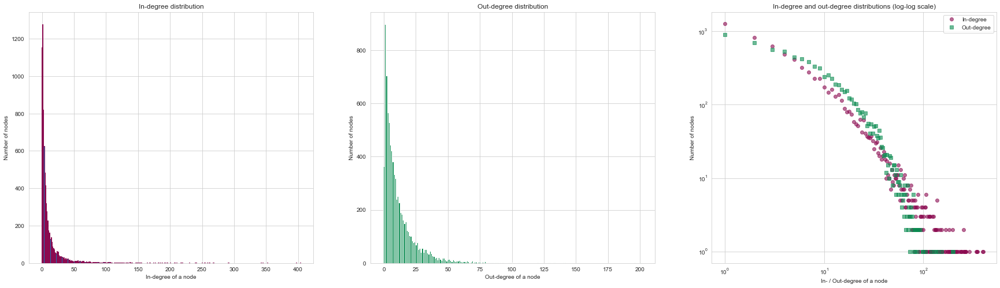

In [17]:
degrees = [GCC.degree(n) for n in GCC.nodes()]
in_degrees = [GCC.in_degree(n) for n in GCC.nodes()]
out_degrees = [GCC.out_degree(n) for n in GCC.nodes()]
stats = [('Mean', np.mean(in_degrees), np.mean(out_degrees)),
         ('Mode', scipy.stats.mode(in_degrees)[0][0], scipy.stats.mode(out_degrees)[0][0]),
         ('Minimum', np.min(in_degrees), np.min(out_degrees)),
         ('Maximum', np.max(in_degrees), np.max(out_degrees))]

print(tabulate(stats, headers=['', 'IN-degree', 'OUT-degree'], tablefmt="fancy_grid"))
plot_distributions(in_degrees, out_degrees)

As said previously, the GCC has 8290 nodes and 96405 edges. The in-degree and out-degree distributions are shown above with some stats. The 10 nodes with the greatest in-degree and out-degree are shown in the Table below. We can see that the maximum in-degree is twice the maximum out-degree. But their mode, 1, and minimum, 0, are the same. Note that the average in-degree is equal to the average out-degree as every edge adds both 1 in- and out- degree.
- We can see that the top 10 artists in regards to IN-degree are all extremely well known. Those musicians have had long careers and have been very influencial. These are most likely being cited as inspiration in a lot of other musicians' wikipedia page. 
- In regards to OUT-degree, the top 10 is more surprising. Those are the artists whose Wikipedia page contains the most link to other artists. Looking at [The Hood Internet](https://en.wikipedia.org/wiki/The_Hood_Internet), an American duo producing Mixtapes/Mashup, we see that their page contains their complete discography, which reference every original artists being remixed. Moreover, [Vitamin String Quartet](https://en.wikipedia.org/wiki/Vitamin_String_Quartet) is a "American musical group, widely known for its series of tribute albums" and their page also contains a detailled discography section. The rest of the list has similar artists as those in the top IN-degree, or more well-known ones. Looking at their pages, we see that they are quite long and detailed, explaining the high number of links in them. 

A more in-depth analysis of the network's attributes and properties is conducted in Section 3.

In [18]:
# Sorted list of tuples (character, degree) 
top_in = sorted(dict(GCC.in_degree()).items(), key= lambda x: x[1], reverse=True)
top_out = sorted(dict(GCC.out_degree()).items(), key= lambda x: x[1], reverse=True)

top_10 = [(x[0],x[1], ' ', y[0],y[1]) for x,y in zip(top_in[:10], top_out[:10])]

print(tabulate(top_10, headers=['Artist','IN-degree','','Artist','OUT-degree'], showindex=range(1,11), tablefmt="fancy_grid"))

╒════╤═════════════════╤═════════════╤════╤════════════════════════╤══════════════╕
│    │ Artist          │   IN-degree │    │ Artist                 │   OUT-degree │
╞════╪═════════════════╪═════════════╪════╪════════════════════════╪══════════════╡
│  1 │ The Beatles     │         403 │    │ The Hood Internet      │          201 │
├────┼─────────────────┼─────────────┼────┼────────────────────────┼──────────────┤
│  2 │ Bob Dylan       │         397 │    │ Vitamin String Quartet │          196 │
├────┼─────────────────┼─────────────┼────┼────────────────────────┼──────────────┤
│  3 │ Michael Jackson │         352 │    │ Bryan Adams            │          152 │
├────┼─────────────────┼─────────────┼────┼────────────────────────┼──────────────┤
│  4 │ David Bowie     │         345 │    │ Iron Maiden            │          141 │
├────┼─────────────────┼─────────────┼────┼────────────────────────┼──────────────┤
│  5 │ Kanye West      │         342 │    │ Eminem                 │        


# 3. Tools, theory and analysis. Describe the process of theory to insight
- Talk about how you've worked with text, including regular expressions, unicode, etc.
- Describe which network science tools and data analysis strategies you've used, how those network science measures work, and why the tools you've chosen are right for the problem you're solving.
-  How did you use the tools to understand your dataset?

# A. Network:

### Regular expressions: see Section 2 above when describing how to extract and clean the data.

### Does the network follow a power law? 
- We use the `powerlaw` package to fit a power law to our degree distribution. Since it works with logarithms, `powerlaw` should only consider nodes with a positive degree. From the numbers of nodes with positive in- and out-degrees, we deduce the number of musicians with null in-degree: 1153 artists only have outgoing edges, and with null out-degree: 365 artists do not point to any other artist in the network.

- We find the degree exponents $\alpha_{in} ≈ 2.91 $ and $\alpha_{out} ≈ 5.53 $.  Without getting into too much detail, the degree exponents are linked to probabilites, and so $\alpha_{out} > \alpha_{in}$ means that the probability of finding high out-degree nodes is lower than that of finding high in-degree nodes. This is what we would expect as there is no limit to the number of artist wikipages that can refer to another artist's page, while an artist's page will contain a limited number of links to others (except if the page contains a whole discography of songs linked to various artists, for example).

- We plot the comparisons between the power law fits and the network's degree distributions below. The degree distribution is quite far off the straight line representing the power law fit, so we can hardly argue that our network's degree distributions follow a power law. This underlines the fact that we are dealing with a real network that does not have the exact same properties as theoretical scale-free networks.


In [19]:
import powerlaw

# Remove nodes of degree 0 for power-law fit
in_degrees1 = [d for d in in_degrees if d>0]
print(len(in_degrees1), "nodes have a positive in-degree")
out_degrees1 = [d for d in out_degrees if d>0]
print(len(out_degrees1), "nodes have a positive out-degree")

# The choice of arguments discrete=True, estimate_discrete=False comes from 
# https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0085777#s5 
# Section "Advanced Considerations"
# § "Discrete Distribution Calculation and Estimation"

alpha_in = powerlaw.Fit(in_degrees1, discrete=True, estimate_discrete=True).alpha
alpha_out = powerlaw.Fit(out_degrees1, discrete=True, estimate_discrete=True).alpha
print("alpha_in =", alpha_in)
print("alpha_out =", alpha_out)

7137 nodes have a positive in-degree
7925 nodes have a positive out-degree
Calculating best minimal value for power law fit
Calculating best minimal value for power law fit
alpha_in = 2.905309324452375
alpha_out = 5.533620381930499


In [20]:
from scipy import special # for the zeta-Riemann function

# Deriving the probability laws
C_in = 1/special.zeta(alpha_in)
C_out = 1/special.zeta(alpha_out)
print("Normalising constants:")
print("C_in =", C_in, "\nC_out =", C_out)

def p_in(k_in, alpha_in=alpha_in, C_in=C_in):
    return C_in*k_in**(-alpha_in)

def p_out(k_out, alpha_out=alpha_out, C_out=C_out):
    return C_out*k_out**(-alpha_out)

powerlaw_in =  [p_in(k_in) for k_in in range(1,max(in_degrees1)+1)]
powerlaw_out =  [p_out(k_out) for k_out in range(1,max(out_degrees1)+1)]

Normalising constants:
C_in = 0.8183654270433979 
C_out = 0.9760160324231276


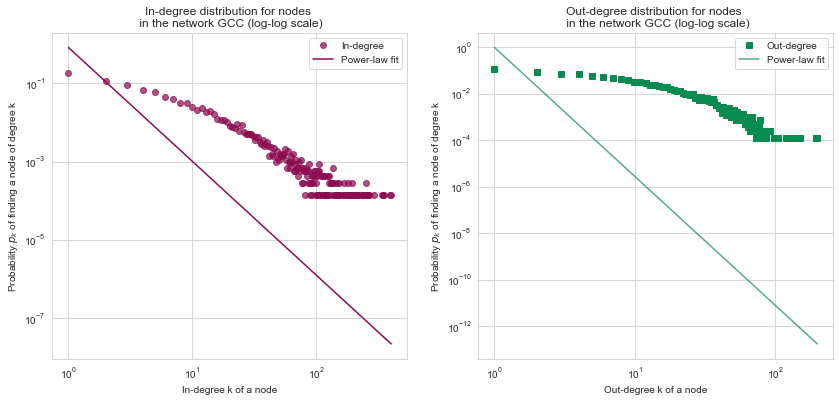

In [21]:
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

hist_in, bin_edges_in = np.histogram(in_degrees1, bins=max(in_degrees1))
axes[0].plot(bin_edges_in[:-1], hist_in/len(in_degrees1), 'o',color='#8B0A50', alpha=0.7, label="In-degree")
axes[0].plot(bin_edges_in[:-1], powerlaw_in, '-',color='#8B0A50', alpha=1, label="Power-law fit")
axes[0].set(xscale='log', yscale='log')
axes[0].set(title='In-degree distribution for nodes \n in the network GCC (log-log scale)',
            xlabel='In-degree k of a node',
            ylabel='Probability $p_k$ of finding a node of degree k')
axes[0].legend()

hist_out, bin_edges_out = np.histogram(out_degrees1, bins=max(out_degrees1))
axes[1].plot(bin_edges_out[:-1], hist_out/len(out_degrees1), 's',color='#0A8B50', alpha=1, label="Out-degree")
axes[1].plot(bin_edges_out[:-1], powerlaw_out, '-',color='#0A8B50', alpha=0.7, label="Power-law fit")
axes[1].set(xscale='log', yscale='log')
axes[1].set(title='Out-degree distribution for nodes \n in the network GCC (log-log scale)',
            xlabel='Out-degree k of a node',
            ylabel='Probability $p_k$ of finding a node of degree k')
axes[1].legend()

plt.show()

## Attributes distributions
In the following, we take a closer look at the attributes of the nodes in the GCC.

**age:** Looking at the distribution of the ages in the network, we see that most artists were born 50 to 25 years ago. 
Note that the few artists whose age is reported as being very young, 0-5 years, are in a sense "mistakes". After inspection, we saw that their birth_date entry in their infobox contains a formula of the form 'compute age as of date xx/yy/zzzz', where zzzz is a recent year, e.g. 2021. These strange cases could be deleted, as there was not easy way to differentiate them from real birth date. 

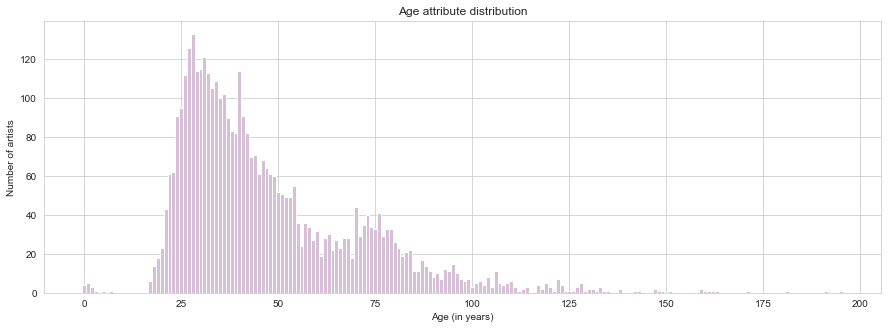

In [22]:
from collections import Counter

artist_age_dict = dict(GCC.nodes(data='age'))
age_distribution = Counter(artist_age_dict.values())

age_distribution.pop('Unknown')

fig, ax = plt.subplots(figsize=(15,5))
ax.bar(x=list(age_distribution.keys()), height=list(age_distribution.values()),  width=1, color='thistle')
ax.set(xlabel='Age (in years)',
       ylabel='Number of artists',
       title='Age attribute distribution')
plt.show()

The most ancient artists in the network, with a specified birth date, is [Stephen Foster](https://en.wikipedia.org/wiki/Stephen_Foster), born in 1826 and "known also as 'the father of American music'".
Note that the network contains more ancient musicians, such as the composers Beethoven and Mozart, however their page does not specify a birth date, but rahter for example the date of their baptize (thus the attribute being 'Unknown').

In [23]:
print(list(artist_age_dict.keys())[list(artist_age_dict.values()).index(195)])

Stephen Foster


**Length of page (number of characters):**

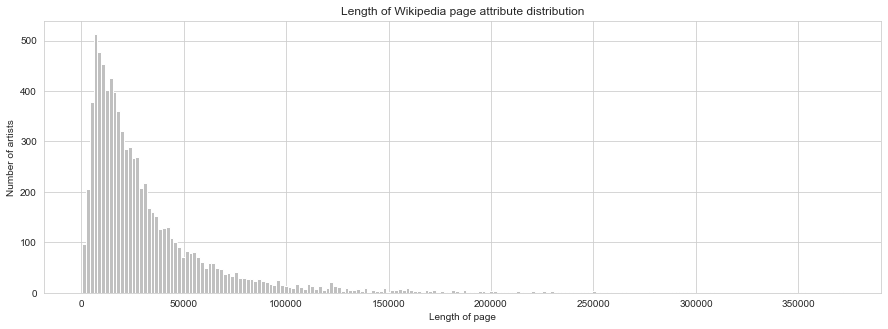

In [24]:
length_pages = list(dict(GCC.nodes(data='lengthPage')).values())
artist_length_dict = dict(GCC.nodes(data='lengthPage'))

fig, ax = plt.subplots(1, 1, figsize=(15,5))
ax.hist(length_pages, bins=200, color='silver')
ax.set(xlabel='Length of page',
       ylabel='Number of artists',
       title='Length of Wikipedia page attribute distribution')
plt.show()

In [25]:
print('TOP 10 Longest Wikipedia Pages:')
for l in sorted(length_pages, reverse=True)[:10]:
    print(l, ':', list(artist_length_dict.keys())[list(artist_length_dict.values()).index(l)])
print('\nShortest Wikipedia Page:')
for l in sorted(length_pages, reverse=True)[-1:]:
    print(l, ':', list(artist_length_dict.keys())[list(artist_length_dict.values()).index(l)])

TOP 10 Longest Wikipedia Pages:
371774 : Taylor Swift
352396 : Beyoncé
346332 : Guns N' Roses
307842 : Kanye West
297239 : Lady Gaga
292603 : Iron Maiden
290524 : PewDiePie
289708 : Marilyn Manson (band)
278774 : Mariah Carey
265335 : Frank Sinatra

Shortest Wikipedia Page:
471 : Ramon Ayala


In [26]:
ages = [v for v in artist_age_dict.values() if v != 'Unknown']
stats = [('Mean', np.mean(ages), np.mean(length_pages)),
         ('Mode', scipy.stats.mode(ages)[0][0], scipy.stats.mode(length_pages)[0][0]),
         ('Minimum', np.min(ages), np.min(length_pages)),
         ('Maximum', np.max(ages), np.max(length_pages))]

print(tabulate(stats, headers=['', 'Age', 'LengthPage'], tablefmt="fancy_grid"))

╒═════════╤══════════╤══════════════╕
│         │      Age │   LengthPage │
╞═════════╪══════════╪══════════════╡
│ Mean    │  47.5154 │      32488.2 │
├─────────┼──────────┼──────────────┤
│ Mode    │  28      │       6193   │
├─────────┼──────────┼──────────────┤
│ Minimum │   0      │        471   │
├─────────┼──────────┼──────────────┤
│ Maximum │ 195      │     371774   │
╘═════════╧══════════╧══════════════╛


**genres:**
Note that an artist can have multiple genres. Thus, being counted once for each of their genres.

In [27]:
artist_genres_dict = dict(GCC.nodes(data='genres'))
genre_artists_dict = {}
for artist, genres in artist_genres_dict.items():
    for genre in genres:
        if genre in genre_artists_dict.keys():
            genre_artists_dict[genre] += [artist]
        else:
            genre_artists_dict[genre] = [artist]
            
genre_popularity = {g:len(artists) for g,artists in genre_artists_dict.items()}
genre_popularity_sorted = dict(sorted(genre_popularity.items(), key=lambda kv: kv[1], reverse=True))

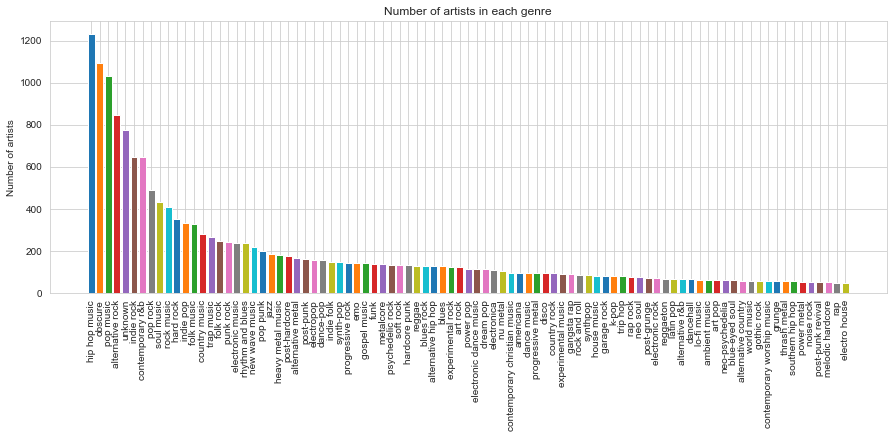

In [28]:
fig, ax = plt.subplots(figsize=(15,5))
ax.bar(x=list(genre_popularity_sorted.keys()),
       height=list(genre_popularity_sorted.values()),
       color=['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9'])
ax.set(ylabel='Number of artists',
       title='Number of artists in each genre')
ax.xaxis.set_tick_params(rotation=90)
plt.show()

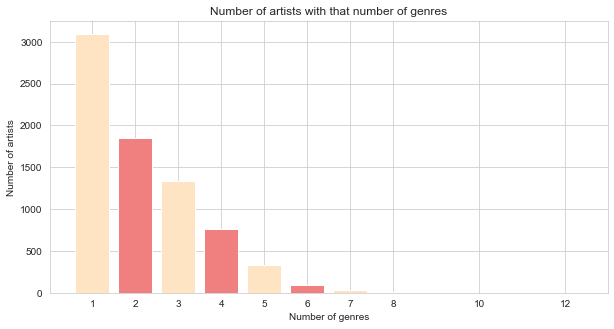

In [29]:
artist_nb_genres_dict = {k:len(v) for k,v in artist_genres_dict.items()  if 'unknown' not in v}
nb_genres_distribution = dict(sorted(Counter(artist_nb_genres_dict.values()).items(), key=lambda kv: kv[0], reverse=True))

fig, ax = plt.subplots(figsize=(10,5))
ax.bar(x=list(nb_genres_distribution.keys()),
       height=list(nb_genres_distribution.values()),
       color=['lightcoral', 'bisque'],)
ax.set(xlabel='Number of genres',
       ylabel='Number of artists',
       title='Number of artists with that number of genres',
       xticks=list(nb_genres_distribution.keys()))
plt.show()

The artists with the most specified genres, 12, is [Gustavo Cerati](https://en.wikipedia.org/wiki/Gustavo_Cerati), "an Argentine singer-songwriter, composer and producer, considered one of the most important and influential figures of Ibero-American rock". Looking at his attribute, we see that most of them are indeed different types of 'rock'.

The [Wikipedia documentation for Infobox of musical artists](https://en.wikipedia.org/wiki/Template:Infobox_musical_artist#:~:text=the%20field%20%22birth_place%22.-,genre,-The%20genre%20or) recommends giving 2-4 genres per artist, but it is likely that not all Wikipedia contributors are aware of this guideline.

In [30]:
artist_extra = max(artist_nb_genres_dict, key=artist_nb_genres_dict.get)
print(artist_extra, GCC.nodes[artist_extra])

Gustavo Cerati {'age': 62, 'genres': ['rock music', 'alternative rock', 'electronic rock', 'pop rock', 'experimental rock', 'neo-psychedelia', 'art rock', 'new wave music', 'post-punk', 'power pop', 'electronica', 'indie rock'], 'lengthPage': 41044}


## More advanced attributes inspection

### Degree
**IN- degree vs OUT-degree**

We expect to find a relationship between in-degree and out-degree, as both will likely increase with an artist's fame. Indeed, plotting the out-degree against the in-degree shows a form a proportionality between the two degrees. There are some outliers, with high in-degree but low out-degree, and vice versa. An example of high out-degree, but low in-degree, are pages of artists that make mashups or remixes of songs by other artists, but are not well-known themselves.

The vast majority of nodes have degrees between 0 and 5, as shown in the zoomed heatmap. The most common situation (the darkest square) is an in-degree of 0, with an out-degree of 1. These artists are not referred to by anybody else, and only link to 1 musician, maybe their primary source of inspiration.

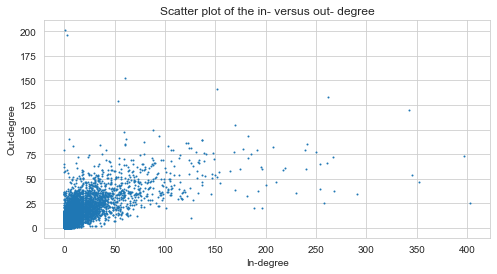

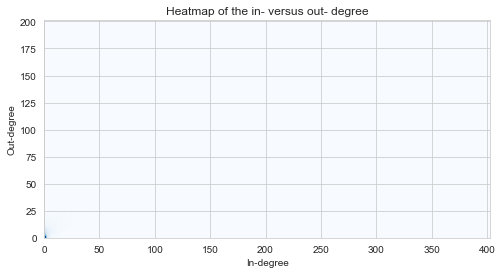

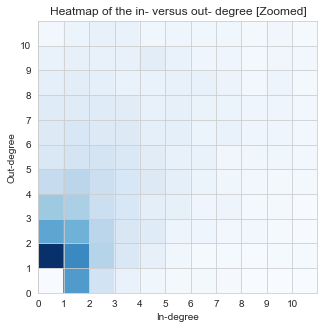

In [31]:
# In- versus out-degree
figsize = (8,4)
fig, ax= plt.subplots(1, 1, figsize=figsize)
ax.scatter(in_degrees, out_degrees, s=1)
ax.set(xlabel='In-degree',
            ylabel='Out-degree',
            title='Scatter plot of the in- versus out- degree')
plt.show()

fig, ax= plt.subplots(1, 1, figsize=figsize)
heatmap, xedges, yedges = np.histogram2d(in_degrees, out_degrees, bins=(200, 100))
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]

ax.imshow(heatmap.T, extent=extent, origin='lower', aspect='auto', cmap='Blues') #cmap='YlOrRd' # binary
ax.set(xlabel='In-degree',
            ylabel='Out-degree',
            title='Heatmap of the in- versus out- degree')
plt.show()


fig, ax = plt.subplots(1, 1, figsize=(5,5))
heatmap, xedges, yedges = np.histogram2d(in_degrees, out_degrees, bins=(max(in_degrees), max(out_degrees)))
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]

upper_x, upper_y = 11, 11
ax.imshow(heatmap.T, extent=extent, origin='lower', aspect='auto', cmap='Blues') #cmap='YlOrRd' # binary
ax.set(xlabel='In-degree',
            ylabel='Out-degree',
            title='Heatmap of the in- versus out- degree [Zoomed]',
            xlim=[0,upper_x],
            ylim=[0,upper_y],
            xticks=range(upper_x),
            yticks=range(upper_y))
plt.show()

**Length of page vs degree**

Again, we expect to find, and indeed notice, a correlation between the length of an artist's wikipage and their degree. The link between out-degree and length of page is the most obvious: a long text is naturally more likely to contain more links. We plot the out-degree vs length of page to serve as a reference for comparison with the in-degree vs length of page plot. There is no clear difference between the relationships of in-degree and out-degree with length of page.


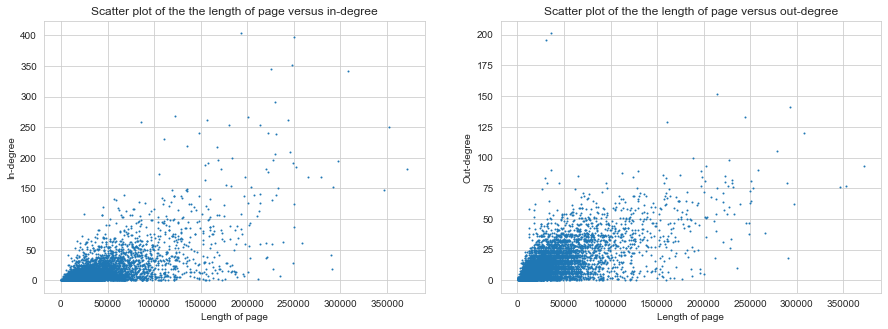

In [32]:
# Length of page against in-, out-degree
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
axes[0].scatter(length_pages, in_degrees, s=1)
axes[0].set(xlabel='Length of page',
            ylabel='In-degree',
            title='Scatter plot of the the length of page versus in-degree')
axes[1].scatter(length_pages, out_degrees, s=1)
axes[1].set(xlabel='Length of page',
            ylabel='Out-degree',
            title='Scatter plot of the the length of page versus out-degree')
plt.show()

## Centrality measures

The centrality of a node measures how *central* it is in the network, under various definitions of what we mean with "central". `networkx` provides easy tools to measure degree, betweenness and eigenvector centrality.

**Degree centrality**

The [degree centrality](https://networkx.org/documentation/networkx-2.1/reference/algorithms/generated/networkx.algorithms.centrality.degree_centrality.html#networkx.algorithms.centrality.degree_centrality) of a node is the proportion of nodes in the network it is connected to. It is simply the total degree (in-degree + out-degree) divided by the number of nodes - 1. Hence we recognise some of our top degree artists, mainly top in-degree. Indeed, some of the top out-degree artists that we found, such as the pages [The Hood Internet](https://en.wikipedia.org/wiki/The_Hood_Internet) and [Vitamin String Quartet](https://en.wikipedia.org/wiki/Vitamin_String_Quartet) contained extroardinarily high numbers of links but were not pointed to by many others. Generally, the high in-degree weighs more in the computation of the degree than the out-degree does. 

In [33]:
# Degree centrality
degree_centrality = nx.algorithms.centrality.degree_centrality(GCC)
degree_centrality_sorted = sorted(degree_centrality.items(), key=lambda item: item[1], reverse=True)
print(tabulate(degree_centrality_sorted[:10], headers=['Character', 'Degree centrality'], showindex=range(1,11), tablefmt="fancy_grid"))

╒════╤═════════════════╤═════════════════════╕
│    │ Character       │   Degree centrality │
╞════╪═════════════════╪═════════════════════╡
│  1 │ Bob Dylan       │           0.0567017 │
├────┼─────────────────┼─────────────────────┤
│  2 │ Kanye West      │           0.0557365 │
├────┼─────────────────┼─────────────────────┤
│  3 │ The Beatles     │           0.0516347 │
├────┼─────────────────┼─────────────────────┤
│  4 │ David Bowie     │           0.0481361 │
├────┼─────────────────┼─────────────────────┤
│  5 │ Michael Jackson │           0.0481361 │
├────┼─────────────────┼─────────────────────┤
│  6 │ Eminem          │           0.0476535 │
├────┼─────────────────┼─────────────────────┤
│  7 │ Elton John      │           0.0408976 │
├────┼─────────────────┼─────────────────────┤
│  8 │ Beyoncé         │           0.0394499 │
├────┼─────────────────┼─────────────────────┤
│  9 │ Jay-Z           │           0.0394499 │
├────┼─────────────────┼─────────────────────┤
│ 10 │ Rihann

**Betweenness centrality**

The [betweenness centrality](https://networkx.org/documentation/networkx-2.1/reference/algorithms/generated/networkx.algorithms.centrality.betweenness_centrality.html#networkx.algorithms.centrality.betweenness_centrality) of a node N shows how often we need to go through N if we want to go from a node A to another node B (looking at the shortest path from A to B).
Were we to play [Wikispeedia](https://dlab.epfl.ch/wikispeedia/play/) on our network, Eminem would most likely be on the shortest path from the start page to goal page, so we should aim at landing on his page.


In [34]:
# Betweenness centrality
betweenness_centrality = nx.betweenness_centrality(GCC, k=200) # k <= n. Higher values give better approximation.
betweenness_centrality_sorted = sorted(betweenness_centrality.items(), key=lambda item: item[1], reverse=True)
print(tabulate(betweenness_centrality_sorted[:10], headers=['Character', 'Betweenness centrality'], showindex=range(1,11), tablefmt="fancy_grid"))

╒════╤══════════════╤══════════════════════════╕
│    │ Character    │   Betweenness centrality │
╞════╪══════════════╪══════════════════════════╡
│  1 │ Eminem       │                0.0211672 │
├────┼──────────────┼──────────────────────────┤
│  2 │ Bob Dylan    │                0.0180261 │
├────┼──────────────┼──────────────────────────┤
│  3 │ Taylor Swift │                0.0175047 │
├────┼──────────────┼──────────────────────────┤
│  4 │ Kanye West   │                0.0173215 │
├────┼──────────────┼──────────────────────────┤
│  5 │ Queen (band) │                0.0154732 │
├────┼──────────────┼──────────────────────────┤
│  6 │ Iron Maiden  │                0.0152954 │
├────┼──────────────┼──────────────────────────┤
│  7 │ Elton John   │                0.0136868 │
├────┼──────────────┼──────────────────────────┤
│  8 │ Coldplay     │                0.0128339 │
├────┼──────────────┼──────────────────────────┤
│  9 │ David Bowie  │                0.012832  │
├────┼──────────────

**Eigenvector centrality** 

The [eigenvector centrality](https://networkx.org/documentation/networkx-2.1/reference/algorithms/generated/networkx.algorithms.centrality.eigenvector_centrality.html#id1) for a node is based on the centrality of its neighbours. Since we expect top in-degree artists to be pointed to by other top degree artists, we again recognise our top in-degree artists. A top in-degree artist would disappear from the top eigenvector centrality list if they were pointed to by many nodes of low degree, which is not common in our network.

In [35]:
# Eigenvector centrality.
# In-degree
eigenvector_centrality_in = nx.algorithms.centrality.eigenvector_centrality(GCC, max_iter=1000)
eigenvector_centrality_in_sorted = sorted(eigenvector_centrality_in.items(), key=lambda item: item[1], reverse=True)
print(tabulate(eigenvector_centrality_in_sorted[:10], headers=['Character', 'Eigenvector centrality IN-'], showindex=range(1,11), tablefmt="fancy_grid"))
# Out-degree
eigenvector_centrality_out = nx.algorithms.centrality.eigenvector_centrality(GCC.reverse(), max_iter=1000)
eigenvector_centrality_out_sorted = sorted(eigenvector_centrality_out.items(), key=lambda item: item[1], reverse=True)
print(tabulate(eigenvector_centrality_out_sorted[:10], headers=['Character', 'Eigenvector centrality OUT-'], showindex=range(1,11), tablefmt="fancy_grid"))

╒════╤═════════════════╤══════════════════════════════╕
│    │ Character       │   Eigenvector centrality IN- │
╞════╪═════════════════╪══════════════════════════════╡
│  1 │ Kanye West      │                     0.171059 │
├────┼─────────────────┼──────────────────────────────┤
│  2 │ Michael Jackson │                     0.163222 │
├────┼─────────────────┼──────────────────────────────┤
│  3 │ Jay-Z           │                     0.142224 │
├────┼─────────────────┼──────────────────────────────┤
│  4 │ Eminem          │                     0.136173 │
├────┼─────────────────┼──────────────────────────────┤
│  5 │ Elvis Presley   │                     0.135479 │
├────┼─────────────────┼──────────────────────────────┤
│  6 │ Rihanna         │                     0.131899 │
├────┼─────────────────┼──────────────────────────────┤
│  7 │ Beyoncé         │                     0.129604 │
├────┼─────────────────┼──────────────────────────────┤
│  8 │ Elton John      │                     0.1

## Community detection

[Communities](https://en.wikipedia.org/wiki/Community_structure) are sets of nodes within a network that are densely connected to each other and weakly connected to others. In real world networks, there tend to be natural divisions and groupings within the entirety of the set of nodes. In our network, we wonder whether communities could correspond to groupings by genre or age. We used the Louvain algorithm to detect communities, and compared them with communities based on age and genre.
    
    
The [Louvain algorithm](https://en.wikipedia.org/wiki/Louvain_method) is a method that attempts to identify communities within networks by attempting to optimize the modularity of sets of nodes. "Modularity is a scale value between −0.5 (non-modular clustering) and 1 (fully modular clustering) that measures the relative density of edges inside communities with respect to edges outside communities." This means that it identifies clusters of nodes who are highly connected to other nodes inside the community, but not as much with nodes outside the community. To identify communities, the algorithm first assigns each node to a community. Through an iterative process it identifies the maximum modularity assigned based on rearranging the community that a node can be in. The second step is to build a new network where the nodes are the communities identified in the previous step. Note that the Louvain algorithm relies on network properties only (such as nodes and edges) and does not take attibutes into account.

In order to have reproducible results, we set a seed for the Louvain algoritm, which resulted in 19 communities. The sizes of the communities are presented in a bar plot below, as well as their most connected members in a table.

In [36]:
import community as community_louvain

partition = community_louvain.best_partition(UGCC, random_state=60)

# identify the communities
community_artists = {}
for k, v in partition.items():
    if v not in community_artists.keys():
        community_artists[v] = [k]
    else:
        community_artists[v] += [k]

In [37]:
n_commu = len(community_artists)
print('The amount of communities based on the Louvain algorithm is:', n_commu)

The amount of communities based on the Louvain algorithm is: 19


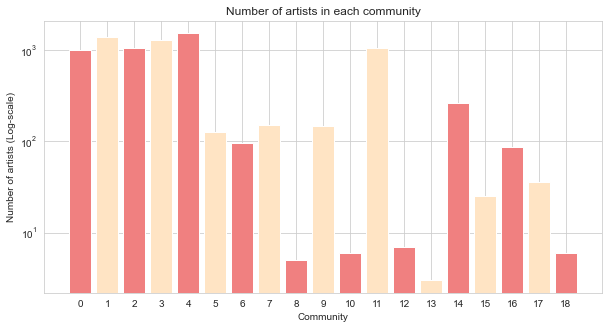

In [38]:
community_size = {k:len(v) for k,v in community_artists.items()}
community_size = dict(sorted(community_size.items(), key=lambda kv: kv[0]))

fig, ax = plt.subplots(figsize=(10,5))
ax.bar(x=list(community_size.keys()),
       height=list(community_size.values()),
       color=['lightcoral', 'bisque'],
       log=True)
ax.set(xlabel='Community',
       ylabel='Number of artists (Log-scale)',
       title='Number of artists in each community',
       xticks=list(community_size.keys()))
plt.show()

An integer is not an informative name to identify a community, so we renamed them after the names of their 3 artists with highest degree.

In [39]:
# Name each community by its three most connected artists, and get their degree distribution
communities_name = {}
communities_degrees = {}
for c, list_artists in community_artists.items():
    artists_deg = {}
    commu_in_degrees, commu_out_degrees = [], []
    for n in list_artists:
        artists_deg[n] = GCC.degree(n)
        commu_in_degrees += [GCC.in_degree(n)]
        commu_out_degrees += [GCC.out_degree(n)]
    # We made sure to check that all communities had at least 3 nodes
    top3 = sorted(artists_deg.items(), key= lambda x: x[1], reverse=True)[:3]
    name = top3[0][0] + '-' + top3[1][0] + '-' + top3[2][0]
    communities_name[c] = name
    communities_degrees[c] = {'in':commu_in_degrees, 'out':commu_out_degrees}

In [40]:
table = []
for i in range(n_commu):
    table += [(i, communities_name[i], community_size[i],
               round(np.mean(communities_degrees[i]['in']),3),
               round(np.mean(communities_degrees[i]['out']),3))]
    
print(tabulate(table, headers=['Community', 'Name', 'Size', 'Avg IN', 'Avg OUT'], tablefmt="fancy_grid"))

╒═════════════╤══════════════════════════════════════════════════════╤════════╤══════════╤═══════════╕
│   Community │ Name                                                 │   Size │   Avg IN │   Avg OUT │
╞═════════════╪══════════════════════════════════════════════════════╪════════╪══════════╪═══════════╡
│           0 │ Michael Jackson-Mariah Carey-Stevie Wonder           │   1010 │   11.645 │    10.351 │
├─────────────┼──────────────────────────────────────────────────────┼────────┼──────────┼───────────┤
│           1 │ Metallica-Queen (band)-Led Zeppelin                  │   1382 │   12.09  │    12.973 │
├─────────────┼──────────────────────────────────────────────────────┼────────┼──────────┼───────────┤
│           2 │ Rihanna-Taylor Swift-Britney Spears                  │   1057 │   10.655 │    12.136 │
├─────────────┼──────────────────────────────────────────────────────┼────────┼──────────┼───────────┤
│           3 │ David Bowie-U2-Nirvana (band)                        │   

## Modularity of partitions

As stated before, the Louvain algorithm aims at maximising the modularity of its partition. But is the resulting modularity really higher than that of a partition by age or genre? We compute the modularities for communities grouped by age (by decade) and by music genre (selecting the first genre of an artist's list of genres). Both are lower than the modularity of the Louvain partition, so age and genre are not enough to understand how artists group themselves into communities.

In [41]:
def compute_modularity(community_nodes, G):
    M = 0
    L = G.number_of_edges()
    for community, nodes in community_nodes.items():
        com = G.subgraph(nodes)
        Lc = com.number_of_edges()
        kc = sum(d for n,d in com.degree)
        M += (Lc/L) - (kc/(2*L))**2

    return M

In [42]:
# Modularity with communities:
compute_modularity(community_artists, GCC)

0.5882294958829298

In [43]:
# Modularity with age by the decades: 
# Hypothesis: artists of the same generation collaborate more between each other?
age_10_artists = {}
for artist, age in artist_age_dict.items():
    age_10 = (age//10)*10 if isinstance(age, int) else age
    if age_10 in age_10_artists.keys():
        age_10_artists[age_10] += [artist]
    else:
        age_10_artists[age_10] = [artist]

tmp = age_10_artists.pop('Unknown', None)
age_10_artists = dict(sorted(age_10_artists.items(), key=lambda kv: kv[0]))
age_10_artists['Unknown'] = tmp

compute_modularity(age_10_artists, GCC)

0.33491283505515845

In [44]:
# Modularity with the first genre:
# Hypothesis: artists of the same genre collaborate more together or mention each other as inspiration?
first_genre_artists = {}
for artist, genres in artist_genres_dict.items():
    first_genre = genres[0]
    if first_genre in first_genre_artists.keys():
        first_genre_artists[first_genre] += [artist]
    else:
        first_genre_artists[first_genre] = [artist]

compute_modularity(first_genre_artists, GCC)

0.24056437689676508

## Confusion matrices: what do the communities contain?

The confusion matrices below, for genre and age, show how many artists of each genre or age are inside each community. The heatmap emphasises on the maximum values on a colourscale. 

For **genres**, we see that most hip-hop artists belong to community 4, followed by community 2. Reciprocally, community 4 is made up of hip-hop artists primarily (870), followed by contemporary R&B (239). Note that an artist belongs to one community only, but may have several genres. 

For **age**, community 1 is made of artists whose age is unknown (reminder: bands, for example, have age="unknown"). Artists in their 20s and 40s belong primarily to communities 2 and 4.



In [45]:
def show_confusion_matrix(attr_nodes_dict, commu_nodes_dict, figsize):
    list_attr = list(attr_nodes_dict.keys())
    list_commu = sorted(list(commu_nodes_dict.keys()))
    R = len(list_attr)
    C = len(list_commu)
    D = np.zeros((R,C), dtype=int)
    for i in range(D.shape[0]):
        for j in range(D.shape[1]):
            nodes_attr = attr_nodes_dict[list_attr[i]]
            nodes_commu = commu_nodes_dict[list_commu[j]]
            # Number of common nodes:
            D[i][j] = len(list(set(nodes_attr) & set(nodes_commu)))

    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(np.log(D), cmap='viridis')
    # We want to show all ticks...
    ax.set_xticks(np.arange(C))
    ax.set_yticks(np.arange(R))
    # ... and label them with the respective list entries
    ax.set_xticklabels(list_commu)
    ax.set_yticklabels(list_attr)
    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")
    # Loop over data dimensions and create text annotations.
    for i in range(R):
        for j in range(C):
            text = ax.text(j, i, D[i, j],
                           ha="center", va="center", color="w")
    plt.grid(False)
    fig.tight_layout()
    plt.show()

<ipython-input-45-4f84a7cc5daa>:15: RuntimeWarning: divide by zero encountered in log
  im = ax.imshow(np.log(D), cmap='viridis')


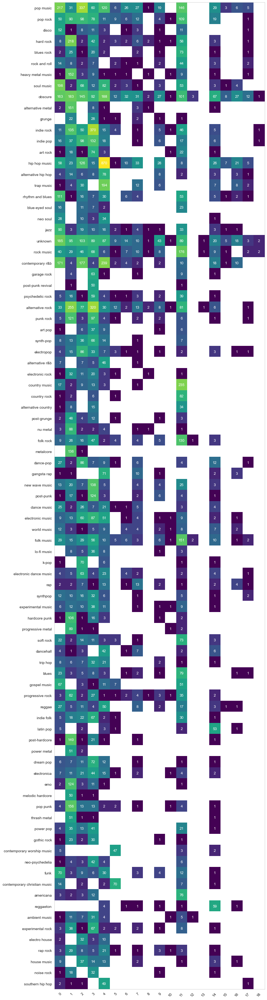

In [46]:
show_confusion_matrix(genre_artists_dict, community_artists, figsize=(10,50))

<ipython-input-45-4f84a7cc5daa>:15: RuntimeWarning: divide by zero encountered in log
  im = ax.imshow(np.log(D), cmap='viridis')


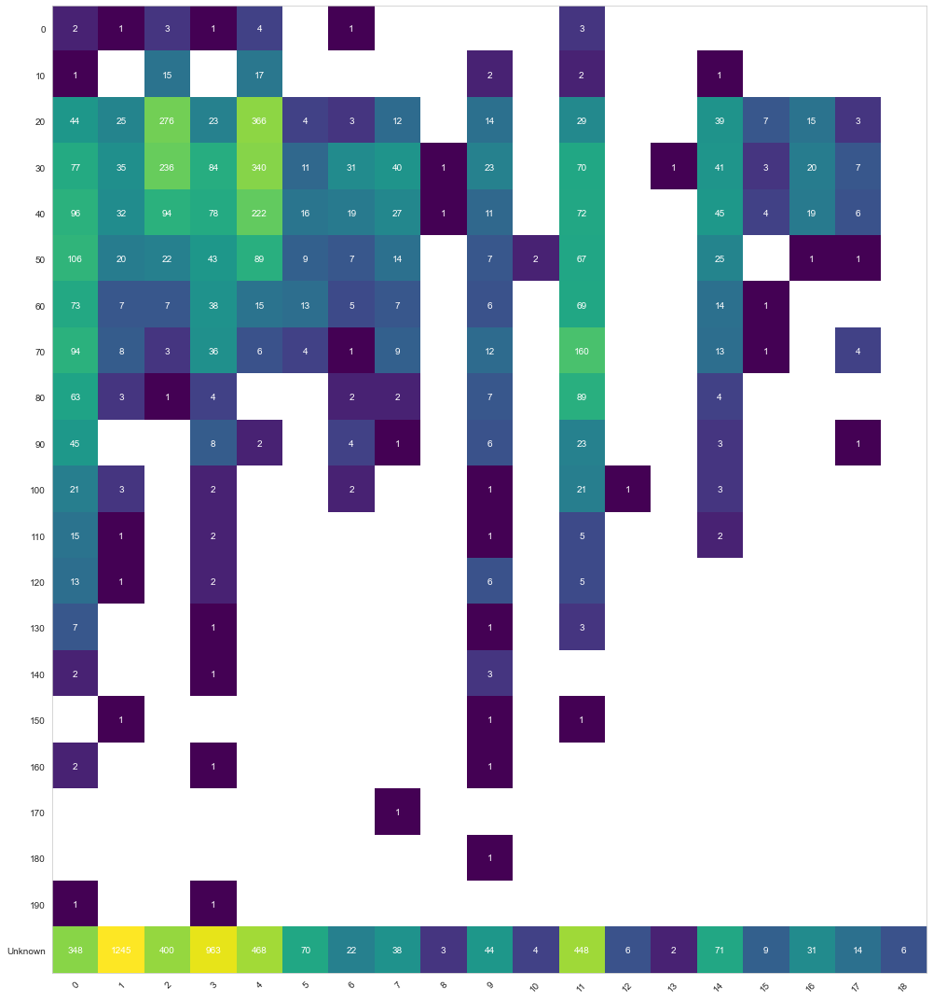

In [47]:
show_confusion_matrix(age_10_artists, community_artists, figsize=(25,15))

## Visualizations

We use ForceAtlas2 to create beautiful and readable visualisations of the undirected GCC.

In [48]:
from fa2 import ForceAtlas2
forceatlas2 = ForceAtlas2(# Behavior alternatives
                          outboundAttractionDistribution=False,  # Dissuade hubs
                          edgeWeightInfluence=1.0,
                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          # Tuning
                          scalingRatio=2.0,
                          strongGravityMode=False,
                          gravity=20.0,
                          verbose=True)

In [50]:
positions = forceatlas2.forceatlas2_networkx_layout(UGCC, pos=None, iterations=2000)

100%|██████████| 2000/2000 [05:08<00:00,  6.48it/s]

BarnesHut Approximation  took  78.30  seconds
Repulsion forces  took  220.75  seconds
Gravitational forces  took  0.63  seconds
Attraction forces  took  1.22  seconds
AdjustSpeedAndApplyForces step  took  3.70  seconds


### Communities & degrees

We assign a colour to a node based on its community, and a size depending on its degree. Communities were automatically grouped together spatially by ForceAtlas2, as shown by the colour blocks.

In [51]:
degrees = dict(UGCC.degree)
node_size = [(v+1) * 10 for v in degrees.values()]

# We use a colormap to define colors for the communities. 
# We switch them around so that the big communities, that have numbers close to each other 0,1,2,3, don’t have also
# colors close to each other in the spectrum.
color_shuffling = {0:2, 1:5, 2:15, 3:3, 4:10, 5:9, 6:4, 7:7, 8:1, 9:11, 10:13, 11:12, 12:6, 13:13, 14:8, 15:14, 16:16, 17:17, 18:0}
node_color = [color_shuffling[p] for p in list(partition.values())]
everynames = ''.join(list(communities_name.values()))
labels = {n: n if n in everynames else '' for n in UGCC.nodes}

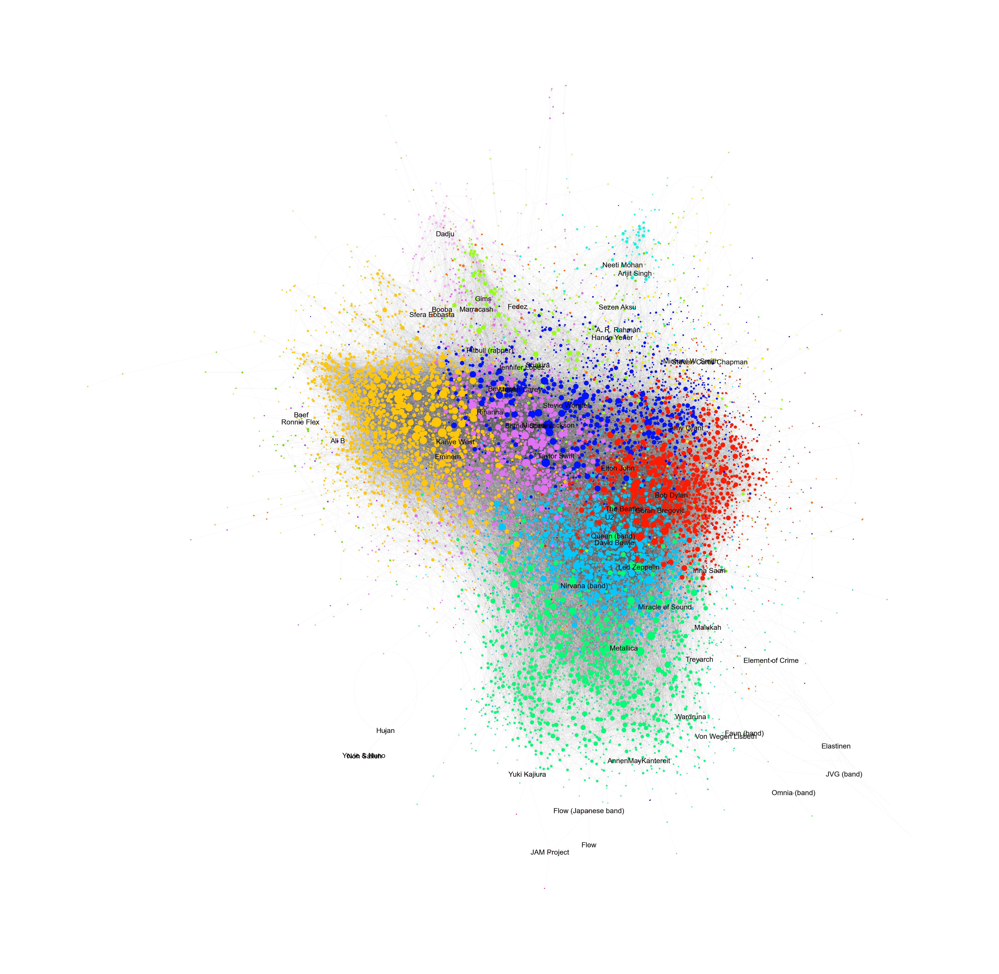

In [52]:
import matplotlib.cm as cm
from matplotlib.colors import LinearSegmentedColormap

fig, ax = plt.subplots(figsize=(100, 100))
# color the nodes according to their partition
cmap = cm.get_cmap('gist_ncar', max(partition.values()) + 1)
nx.draw_networkx_nodes(UGCC, positions, node_size=node_size, cmap=cmap, node_color=node_color)
nx.draw_networkx_edges(UGCC, positions, width=0.5, alpha=0.1)
nx.draw_networkx_labels(UGCC, positions, labels=labels, font_size=40, font_color='black')
plt.axis('off')
plt.show()

Below, we plot the GCC again, but without different colours, to improve readability of the name labels.

In [53]:
degrees = dict(UGCC.degree)
node_size = [(v+1) * 10 for v in degrees.values()]
labels = {n: n if UGCC.degree(n) > 150 else '' for n in UGCC.nodes}

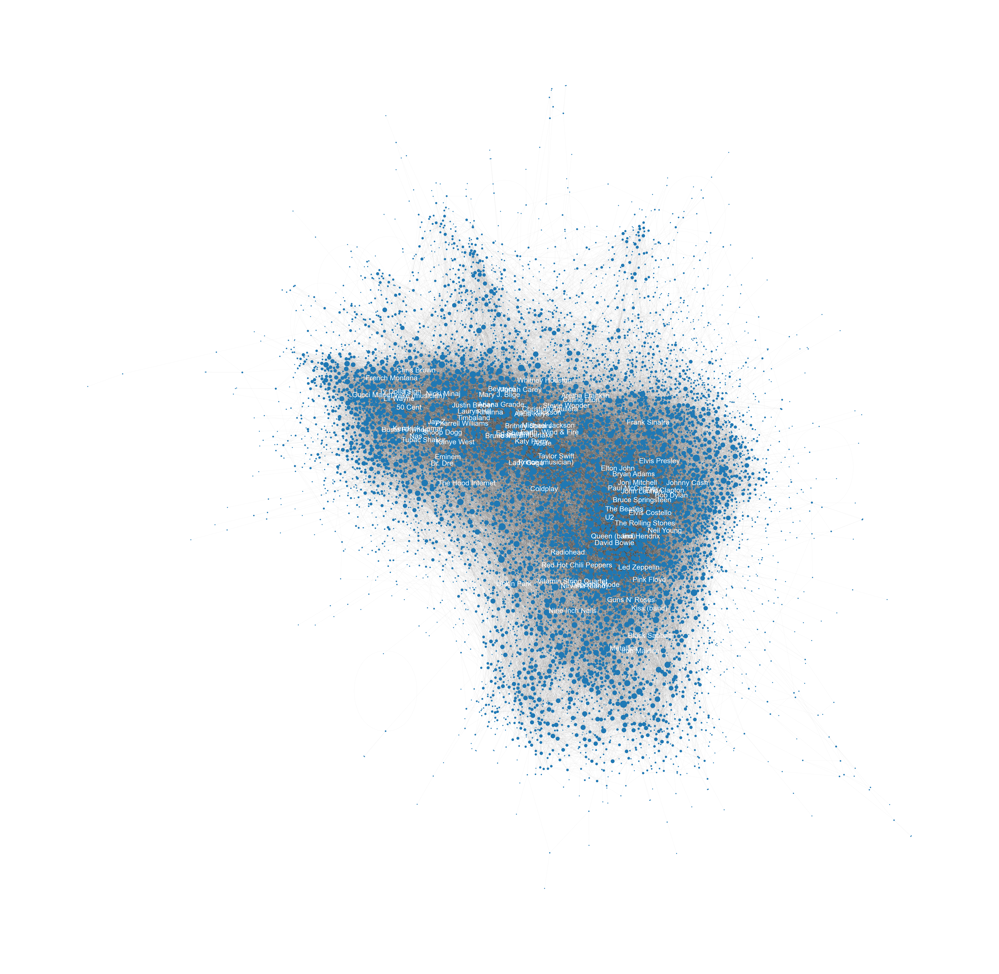

In [54]:
fig, ax = plt.subplots(figsize=(100, 100))
nx.draw_networkx_nodes(UGCC, positions, node_size=node_size)
nx.draw_networkx_edges(UGCC, positions, width=0.5, alpha=0.1)
nx.draw_networkx_labels(UGCC, positions, labels=labels, font_size=40, font_color='white')
plt.axis('off')
plt.show()

The code below creates the plots for all 19 communities, but takes some time to run.

In [55]:
#for i in range(19):
#    print(18-i)
#    nx.draw(UGCC.subgraph(community_artists[18-i]), node_size=50, node_color='#A0CBE2', width=1.3)
#    plt.show()

We use **Bokeh** to create interactive network visuals.

In [56]:
from bokeh.io import output_notebook, show, save
from bokeh.models import Range1d, Circle, ColumnDataSource, MultiLine
from bokeh.plotting import figure
from bokeh.plotting import from_networkx
from bokeh.palettes import Blues8, Reds8, Purples8, Oranges8, Viridis8, Spectral8
from bokeh.transform import linear_cmap

In [57]:
subG = UGCC.subgraph(community_artists[16])
degrees = dict(nx.degree(subG))
nx.set_node_attributes(subG, name='degree', values=degrees)

number_to_adjust_by = 1
adjusted_node_size = dict([(node, degree+number_to_adjust_by) for node, degree in nx.degree(subG)])
nx.set_node_attributes(subG, name='adjusted_node_size', values=adjusted_node_size)

positions_commu = {n:pos for n,pos in positions.items() if n in community_artists[16]}

In [58]:
#Choose attributes from G network to size and color by — setting manual size (e.g. 10) or color (e.g. 'skyblue') also allowed
size_by_this_attribute = 'adjusted_node_size'
color_by_this_attribute = 'adjusted_node_size'

#Pick a color palette — Blues8, Reds8, Purples8, Oranges8, Viridis8
color_palette = Oranges8

#Choose a title!
title = 'Community 16'

#Establish which categories will appear when hovering over each node
HOVER_TOOLTIPS = [
        ("Artist", "@index"),
        ("Degree", "@degree"),
        ("Age", "@age"),
        ("Genres", "@genres")
]

#Create a plot — set dimensions, toolbar, and title
plot = figure(tooltips = HOVER_TOOLTIPS,
              tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
              x_range=Range1d(-100.1, 100.1), y_range=Range1d(-100.1, 100.1), title=title)

#Create a network graph object
# https://networkx.github.io/documentation/networkx-1.9/reference/generated/networkx.drawing.layout.spring_layout.html\
network_graph = from_networkx(subG, nx.spring_layout, scale=100, center=(0, 0), pos=positions) # pos from ForceAtlas2

#Set node sizes and colors according to node degree (color as spectrum of color palette)
minimum_value_color = min(network_graph.node_renderer.data_source.data[color_by_this_attribute])
maximum_value_color = max(network_graph.node_renderer.data_source.data[color_by_this_attribute])
network_graph.node_renderer.glyph = Circle(size=size_by_this_attribute, fill_color=linear_cmap(color_by_this_attribute, color_palette, minimum_value_color, maximum_value_color))

#Set edge opacity and width
network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.1, line_width=0.05)

plot.renderers.append(network_graph)

show(plot)
save(plot, filename=f"{title}.html")

/Users/alaina/opt/anaconda3/lib/python3.8/site-packages/bokeh/io/saving.py:126: UserWarning: save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN
  warn("save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN")
/Users/alaina/opt/anaconda3/lib/python3.8/site-packages/bokeh/io/saving.py:139: UserWarning: save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'
  warn("save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'")


'/Users/alaina/Desktop/classes/2021Fall/Social graphs and interactions/FinalProject/Community 16.html'

# C. Snowball Networks

Snowball networks were part of our initial idea for this project. The networks created with this method depend highly on the initial nodes chosen, so were not ideal to conduct the analysis above about network statistics and lyrics analysis. However, we were still curious to learn more about networks created with snowball sampling methods, and investigate how the choice of a single initial node affects the growth of the network.

## Building a snowball

- **Iteration 0:** We start with a single node A. (Note: we could also choose to start with any given set of nodes)

- **Iteration 1:** We find A's neighbours (B1, B2, ...) in the full network, and connect these neighbours B1, B2, ... with each other, according to the links present in the full network.

- **Iteration 2:** For every B1, B2, ... we do the same as for node A, ie. finding the Bs' neigbours Cs, and drawing the edges existing between the Cs.

- ... and so on for a given number of iterations

### Choosing parameters

- **Initial node:** we compared the snowball networks of the top out-degree, top in-degree and some of our favourite artists. Giant Rooks were particularly interesting as they have the minimal possible out-degree to build a snowball network: 1. Their in-degree is 0, meaning that no snowball network could ever include them, except if they are the starting node.

- **Number of iterations:** We plotted the number of nodes and edges at each iteration below, and noticed a phenomenon similar to a saturation, so decided to stop after 10 iterations.


In [59]:
def prepare_snowball(starting_nodes, n_iter, verbose=True):
    # Dictionaries that will contain all informations about the nodes
    nodes_iter = {k:0 for k in starting_nodes}
    nodes_attributes = {}
    nodes_edges = {}
    for i in tqdm(range(n_iter+1)):
        for node in tqdm(list(nodes_iter.keys()), disable=not verbose):
            # Only explore artists of the CURRENT iteration (not those already explored)
            if nodes_iter[node] == i:
                # Get content
                node_filename = "Wikipages/"+node.replace('/','_')+".txt"
                if os.path.isfile(node_filename):
                    try:
                        with open(node_filename, "r") as f:
                            description = f.read()
                    except:
                        print('Reading .txt file failed:', node)
                else:
                    print('Query wikipedia for', node)
                    description = query_wikipedia(node)
                    try:
                        with open(node_filename,"w") as f:
                            f.write(description)
                    except:
                        print('Writing .txt file failed:', node)
                
                attributes = get_attributes(description)
                targets = get_links(description)
                
                nodes_attributes[node] = attributes
                nodes_edges[node] = targets
                
                for target in targets:
                    # Only consider newly discovered target
                    # So it'll be explored during the NEXT iteration
                    if target not in nodes_iter.keys():
                        nodes_iter[target] = i+1
                        
    return nodes_attributes, nodes_edges, nodes_iter

In [60]:
def build_snowball(nodes_attributes, nodes_edges, nodes_iter, n_iter):
    # ---=== Create GRAPH ===---
    G = nx.DiGraph()  
    # Create nodes
    for node, attr in nodes_attributes.items():
        if nodes_iter[node] <= n_iter:
            G.add_node(node, age=attr['age'], genres=attr['genres'], lengthPage=attr['lengthPage'])
    # Create edges
    for node, edges in nodes_edges.items():
        if nodes_iter[node] <= n_iter:
            for target in edges:
                # Only add edge if target is not in prepped for the last iteration
                if nodes_iter[target] <= n_iter:
                    G.add_edge(node, target)
    return G

In [61]:
input_list = ['Lorde', 'Giant Rooks', 'Chelsea Cutler', 'Clara Luciani', 'The Hood Internet', 'The Beatles']
N_dic = {x:[] for x in input_list}
L_dic = {x:[] for x in input_list}
I = 10
for x in input_list:
    print(x)
    nodes_attributes, nodes_edges, nodes_iter = prepare_snowball([x], n_iter=I, verbose=False)
    for i in range(I+1):
        G = build_snowball(nodes_attributes, nodes_edges, nodes_iter, n_iter=i)
        N_dic[x] += [G.number_of_nodes()]
        L_dic[x] += [G.number_of_edges()]

Lorde


  0%|          | 0/11 [00:00<?, ?it/s]

Giant Rooks


  0%|          | 0/11 [00:00<?, ?it/s]

Chelsea Cutler


  0%|          | 0/11 [00:00<?, ?it/s]

Clara Luciani


  0%|          | 0/11 [00:00<?, ?it/s]

The Hood Internet


  0%|          | 0/11 [00:00<?, ?it/s]

The Beatles


  0%|          | 0/11 [00:00<?, ?it/s]

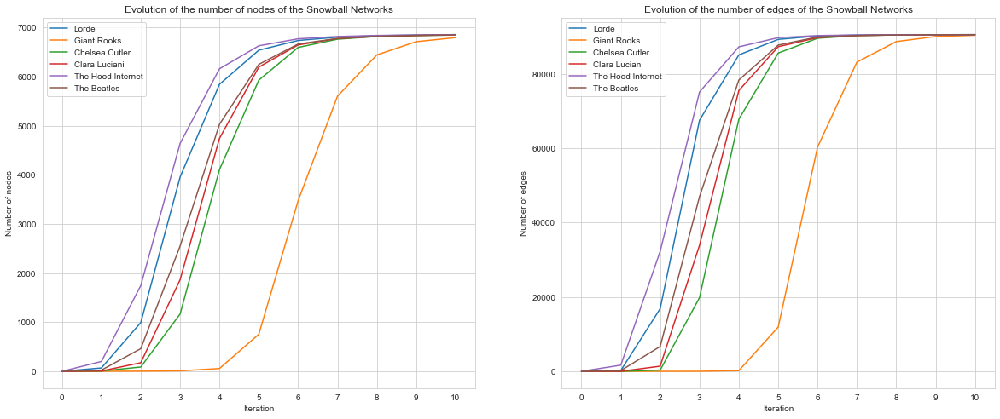

In [62]:
n_iter = np.arange(I+1)
fig, axes = plt.subplots(1, 2, figsize=(20, 8))
for x, n_nodes in N_dic.items():
    axes[0].plot(n_iter, n_nodes, label=x)
axes[0].legend()
axes[0].set(xlabel='Iteration',
            ylabel='Number of nodes',
            title='Evolution of the number of nodes of the Snowball Networks',
            xticks=n_iter)

for x, n_edges in L_dic.items():
    axes[1].plot(n_iter, n_edges, label=x)
axes[1].legend()
axes[1].set(xlabel='Iteration',
            ylabel='Number of edges',
            title='Evolution of the number of edges of the Snowball Networks',
            xticks=n_iter)
plt.show()

The graphs above show how the network's evolution depends on the initial node chosen. Plotting the number of nodes and edges, for various initial settings, illustrates a similar pattern in the network's expansion: after a certain iteration, the network grows rapidly, until saturation. The network does not expand further than ≈6800 nodes and ≈95000 edges. (Reminder: the GCC of the full network has 8290 nodes and 96405 edges).

The Hood Internet, the top out-degree node, has the most rapidly growing network, with already 1000 nodes at iteration 2. Giant Rooks, on the other hand, have an out-degree of 1, and their network still has only 11 nodes at iteration 3.

## Visualizations

We visualise the snowball network at each iteration for Giant Rooks' and Clara Luciani's snowball networks. We colour a node according to the step at which it was added to the network. Note that the size of some nodes changes in between visualisations, as we have browsed through the list of edges to find their neighbours and update their degree.

In [63]:
def visualize_snowball(artist, nodes_attributes, nodes_edges, nodes_iter, n_iter, d_label=0, figsize=(10, 10)):
    G = build_snowball(nodes_attributes, nodes_edges, nodes_iter, n_iter)
    UG = G.to_undirected()

    iter_color = {0:'tab:red', 1:'tab:orange', 2:'tab:green', 3:'tab:blue', 4:'tab:green', 5:'tab:purple', 6:'tab:cyan', 7:'tab:olive', 8:'tab:pink', 9:'tab:brown'}
    node_color = [iter_color[nodes_iter[n]] for n in UG.nodes]
    degrees = dict(UG.degree)
    node_size = [(v+1)*50 for v in degrees.values()] #+1 for isolated nodes (none here)
    labels = {n: n if (UG.degree[n] >= d_label) or n==artist else '' for n in UG.nodes}

    fig, ax = plt.subplots(figsize=figsize)
    positions = forceatlas2.forceatlas2_networkx_layout(UG, pos=None, iterations=2000)
    nx.draw_networkx_nodes(UG, positions, node_color=node_color, node_size=node_size, alpha=0.6)
    nx.draw_networkx_edges(UG, positions, width=0.5, alpha=0.1)
    nx.draw_networkx_labels(UG, positions, labels=labels, font_size=7, font_color='black')
    plt.axis('off')
    plt.show()

In [64]:
nodes_attributes, nodes_edges, nodes_iter = prepare_snowball(['Giant Rooks'], n_iter=5, verbose=False)

  0%|          | 0/6 [00:00<?, ?it/s]

100%|██████████| 2000/2000 [00:00<00:00, 63645.53it/s]

BarnesHut Approximation  took  0.01  seconds
Repulsion forces  took  0.01  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.01  seconds


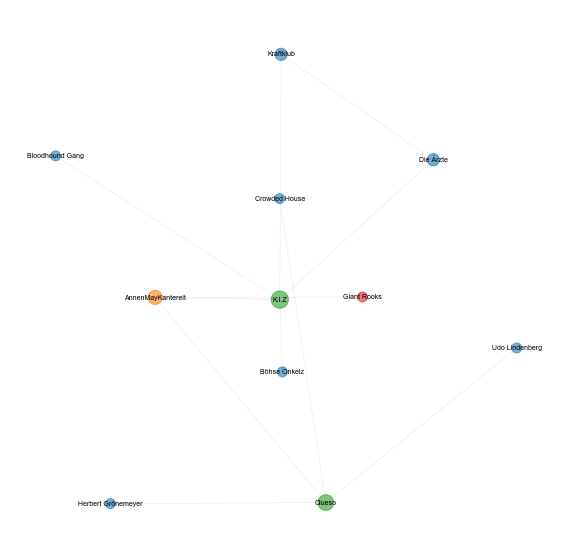

In [65]:
visualize_snowball('Giant Rooks', nodes_attributes, nodes_edges, nodes_iter, n_iter=3)

100%|██████████| 2000/2000 [00:00<00:00, 8798.60it/s]


BarnesHut Approximation  took  0.05  seconds
Repulsion forces  took  0.12  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.03  seconds


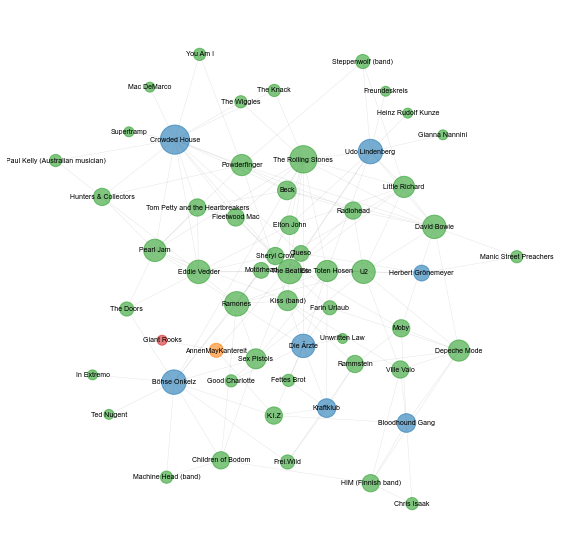

In [66]:
visualize_snowball('Giant Rooks', nodes_attributes, nodes_edges, nodes_iter, n_iter=4)

100%|██████████| 2000/2000 [00:09<00:00, 211.14it/s]


BarnesHut Approximation  took  1.87  seconds
Repulsion forces  took  6.80  seconds
Gravitational forces  took  0.06  seconds
Attraction forces  took  0.10  seconds
AdjustSpeedAndApplyForces step  took  0.34  seconds


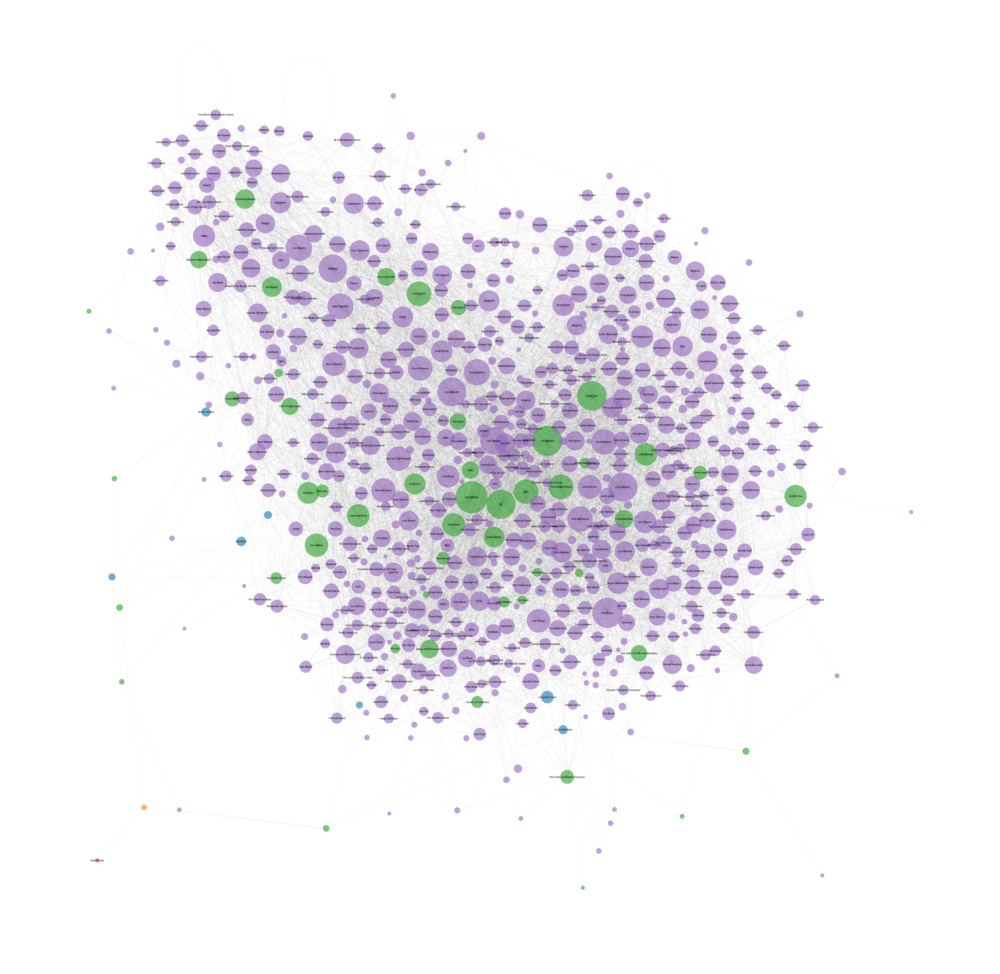

In [67]:
visualize_snowball('Giant Rooks', nodes_attributes, nodes_edges, nodes_iter, n_iter=5, d_label=10, figsize=(50, 50))

In [68]:
nodes_attributes, nodes_edges, nodes_iter = prepare_snowball(['Clara Luciani'], n_iter=5, verbose=False)

  0%|          | 0/6 [00:00<?, ?it/s]

100%|██████████| 2000/2000 [00:00<00:00, 84273.74it/s]

BarnesHut Approximation  took  0.01  seconds
Repulsion forces  took  0.00  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.00  seconds


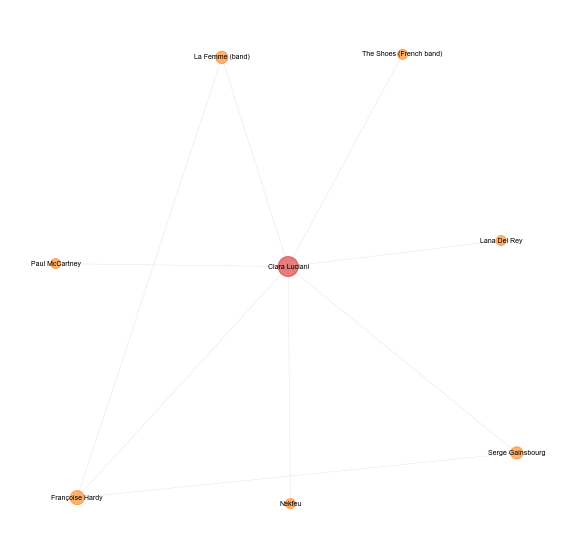

In [69]:
visualize_snowball('Clara Luciani', nodes_attributes, nodes_edges, nodes_iter, n_iter=1)

100%|██████████| 2000/2000 [00:01<00:00, 1818.21it/s]


BarnesHut Approximation  took  0.24  seconds
Repulsion forces  took  0.69  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.01  seconds
AdjustSpeedAndApplyForces step  took  0.08  seconds


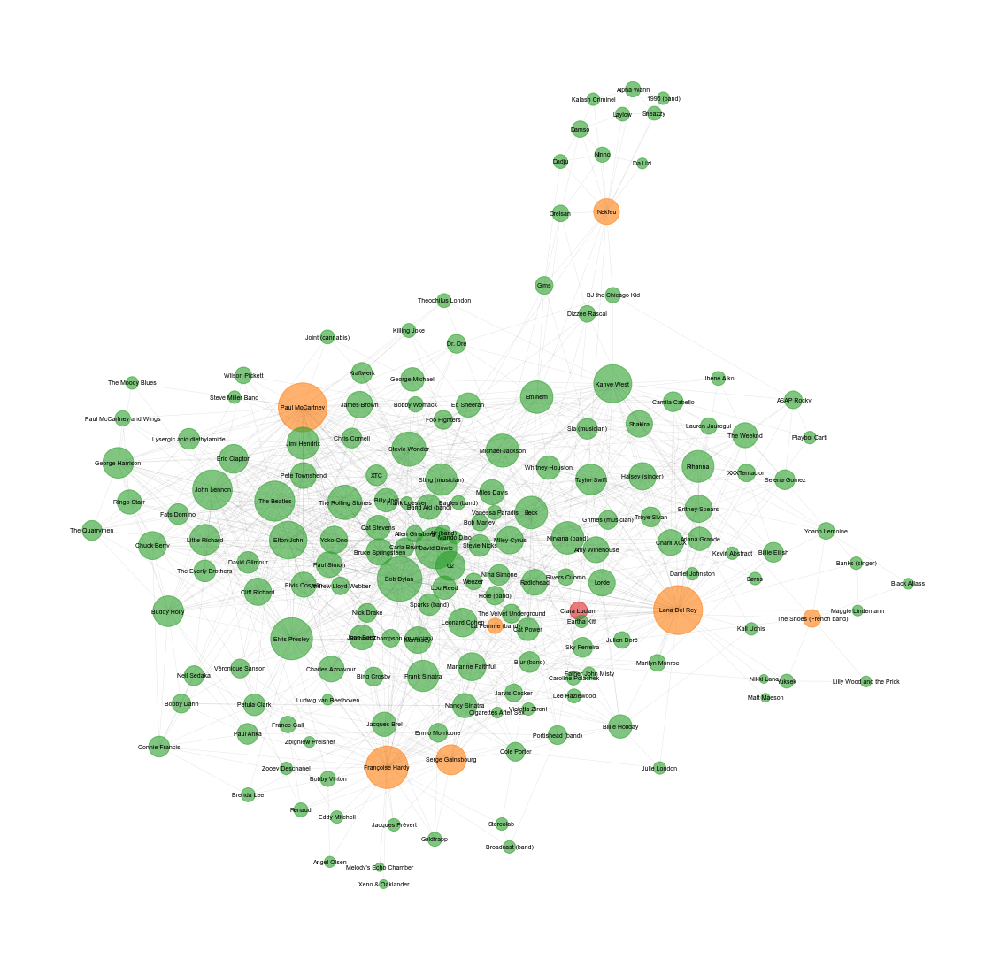

In [70]:
visualize_snowball('Clara Luciani', nodes_attributes, nodes_edges, nodes_iter, n_iter=2, figsize=(20,20))

100%|██████████| 2000/2000 [00:25<00:00, 77.37it/s]


BarnesHut Approximation  took  6.54  seconds
Repulsion forces  took  17.28  seconds
Gravitational forces  took  0.15  seconds
Attraction forces  took  0.31  seconds
AdjustSpeedAndApplyForces step  took  0.83  seconds


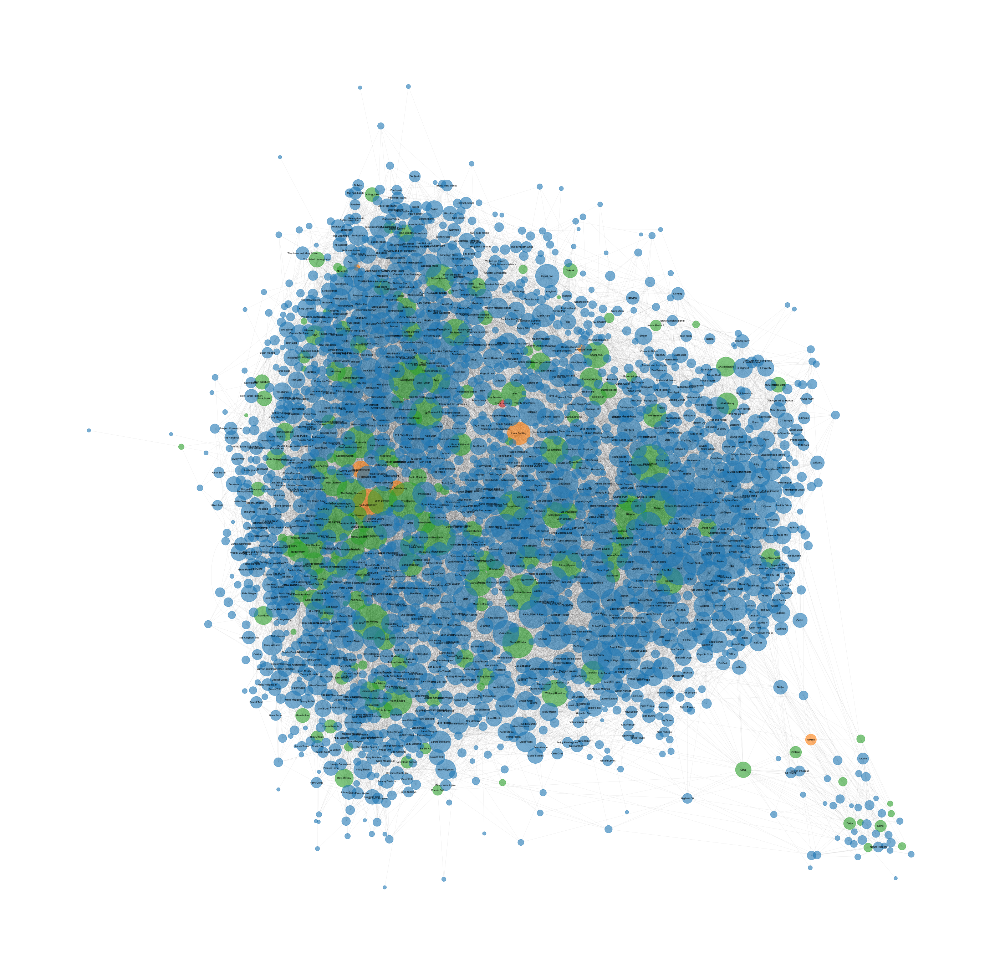

In [71]:
visualize_snowball('Clara Luciani', nodes_attributes, nodes_edges, nodes_iter, n_iter=3, d_label=15, figsize=(50,50))

# 4. Discussion. Think critically about your creation

### A. Network Analysis

#### What went well?
1. Our network has an extremely large amount of musical artists across many genres, languages, and countries. It was extremely interesting to view data for such a gigantic list of artists. Visualizing the communities using the Louvain algorithm gave quite compelling results! (side note: community detection actually helped us an incredible amount for finding errant nodes, as discussed in the What could be improved section. The communities ended up being clear 'wrong' nodes, like animals or cities.. so it was nice that Louvain grouped them together for us :) ). 
2. It was interesting to view the snowball network analysis and see how different iterations of links could achieve nearly the same end network.

#### What is still missing? 
1. The extraction of nodal attributes was extremely difficult due to the wide variety of formats that every wiki page of the 11,000+ nodes had! We initially intended to have the artists' country, but it was not stored in any easily accessible way in the wiki pages. We could have used another dataset to identify the country, but that could be in the next round of analysis.

#### What could be improved? Why?
1. We did not have a fully accurate way to identify if links on the wiki pages were to legitimate musical artists. We had a quite large cleanup where we identified strange links that became nodes in our network. 
2. As discussed earlier, the extraction of nodal attributes was extremely difficult due to the wide variety of formats that every wiki page of the 11,000+ nodes had! We could investigate options to make it more effective in the future.